In [1]:
import torch
import matplotlib.pyplot as plt
from torch import optim, distributions, nn
from tqdm.notebook import tqdm
import gpzoo
from gpzoo.gp import GaussianPrior
from gpzoo.likelihoods import PNMF
from gpzoo.utilities import train_hybrid, train_hybrid_batched, anndata_to_train_val
import squidpy as sq
import numpy as np
from sklearn.decomposition import NMF
import scanpy as sc
import random

from gpzoo.utilities import regularized_nmf, dims_autocorr
from matplotlib.animation import FuncAnimation


/gladstone/engelhardt/home/lchumpitaz/gitclones/GPzoo/gpzoo/utilities.py:2: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm
/gladstone/engelhardt/home/lchumpitaz/miniconda3/envs/nsf/lib/python3.9/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/gladstone/engelhardt/home/lchumpitaz/miniconda3/envs/nsf/lib/python3.9/site-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()


In [2]:
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=1)

In [3]:
new_model=False

In [4]:
adata = sq.datasets.slideseqv2()
adata = adata.raw.to_adata()

In [5]:
adata.var["mt"] = adata.var_names.str.startswith("mt-")

In [6]:
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

<Axes: >

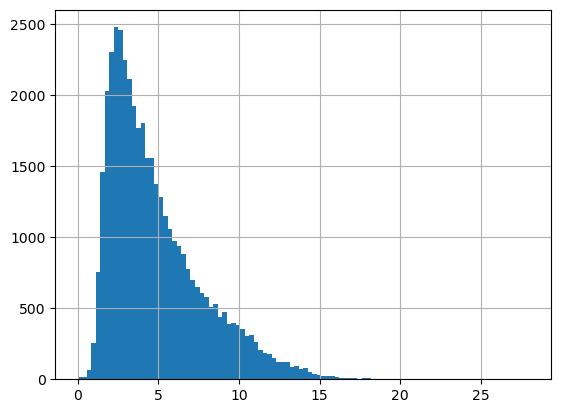

In [7]:
adata.obs.pct_counts_mt.hist(bins=100)

In [8]:
adata = adata[adata.obs.pct_counts_mt < 20] #from 53K to 45K

In [9]:
sc.pp.filter_cells(adata, min_counts=100)

/gladstone/engelhardt/home/lchumpitaz/miniconda3/envs/nsf/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_counts'] = number


In [10]:
sc.pp.filter_genes(adata, min_cells=1)

In [11]:
idx = list(range(adata.shape[0]))
random.shuffle(idx)
adata = adata[idx]

In [12]:
Dtr, Dval = anndata_to_train_val(adata, sz="scanpy")

In [13]:
# Y_sums = np.array(np.sum(adata.X > 0, axis=0))[0]

# Y_nsf = np.array(adata.X[:, Y_sums>100].todense() * 100, dtype=int).T
# Y = np.array(adata.X[:].todense()*100, dtype=int).T

In [14]:
Y = Dtr['Y'].T

In [15]:
X = Dtr['X']*50.0

/gladstone/engelhardt/home/lchumpitaz/miniconda3/envs/nsf/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:26: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/gladstone/engelhardt/home/lchumpitaz/miniconda3/envs/nsf/lib/python3.9/site-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


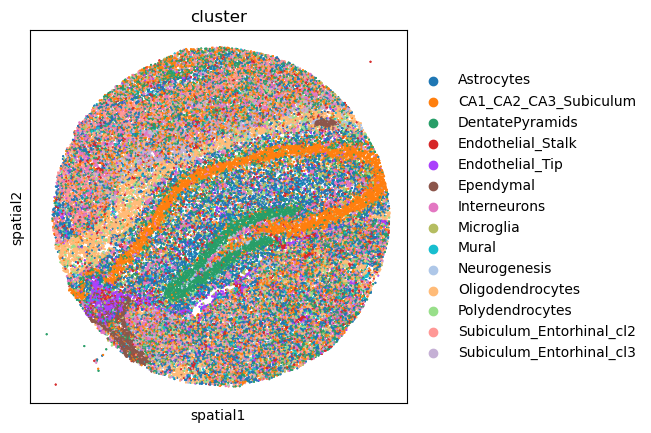

In [16]:
sq.pl.spatial_scatter(adata, color="cluster", size=1, shape=None)

# plt.figure(figsize=(10, 10))
# for i, category in enumerate(adata.obs.cluster.values.categories):
#     mask = adata.obs.cluster.values==category
#     plt.subplot(4, 4, i+1)
#     plt.title(category, fontsize=8)
#     plt.scatter(adata.obs.x[mask], adata.obs.y[mask], alpha=0.1, s=2)
#     plt.xlim([0, 6000])
#     plt.ylim([0, 6000])
#     plt.gca().invert_yaxis()
#     plt.xticks([])
#     plt.yticks([])

In [17]:
# factors, loadings = regularized_nmf(Y.T, L=20, shrinkage=0.3, max_iter = 40, solver='mu', init='nndsvdar', beta_loss='kullback-leibler', random_state=12)

In [18]:
# moran_idx, moranI = dims_autocorr(np.exp(factors), X)

In [19]:
# factors_ordered = factors[:, moran_idx]
# loadings_ordered = loadings[:, moran_idx]

In [20]:
X = torch.tensor(X, dtype=torch.float)
Y = torch.tensor(Y, dtype=torch.float)

In [21]:
L = 20
prior = GaussianPrior(Y, L=L)
model = PNMF(prior, Y, L=L)
model.to(device)

PNMF(
  (prior): GaussianPrior()
)

In [22]:
def train(model, optimizer, y, device, steps=200, E=20, **kwargs):
    losses = []
    
    means = []
    scales = []
    
    for it in tqdm(range(steps)):
        
        optimizer.zero_grad()
        pY, qF, pF = model.forward(E=E, **kwargs)

        logpY = y*torch.log(pY.rate) - pY.rate

        ELBO = (logpY).mean(axis=0).sum()
        ELBO -= torch.sum(distributions.kl_divergence(qF, pF))

        loss = -ELBO
        loss.backward()
        optimizer.step()

        #keep W and W2 positive after updates
        
        #model.W.data = torch.clamp(model.W.data, min=0.0)

        losses.append(loss.item())
        if (it%10)==0:
            means.append(torch.exp(qF.mean.detach().cpu()).numpy())
            scales.append(qF.scale.detach().cpu().numpy())
    
    with torch.no_grad():
        if device.type=='cuda':
            torch.cuda.empty_cache()
        
    return losses, means, scales

In [23]:
# X_train = X.to(device)
Y_train = Y.to(device)

In [24]:
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-1)

In [25]:
# model.gp.jitter=5e-2

In [34]:
model.to(device)
losses, means, scales = train(model, optimizer, Y_train, device, steps=5000, E=1)

  0%|          | 0/5000 [00:00<?, ?it/s]

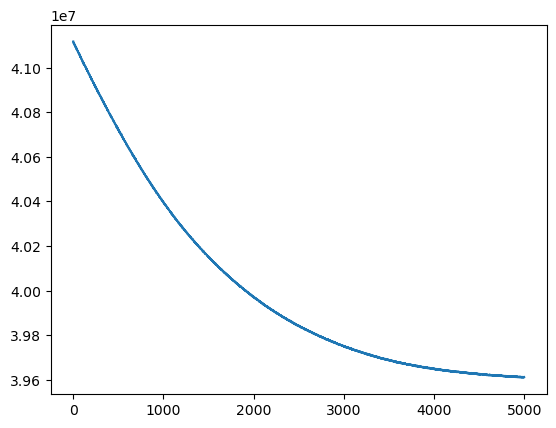

In [35]:
plt.plot(losses)

In [36]:
model.cpu()

qF, pF= model.prior()

factors = torch.exp(qF.mean).detach().cpu().numpy()
factors_scales = torch.nn.functional.softplus(qF.scale.detach().cpu()).numpy()


del qF, pF
with torch.no_grad():
    if device.type=='cuda':
        torch.cuda.empty_cache()

In [37]:
moran_idx, moranI = dims_autocorr(factors.T, X)

In [48]:
def plot(factors, moran_idx, ax=None, size=7):
    
    max_val = np.percentile(factors, 99)
    min_val = np.percentile(factors, 1)

    if ax is None:
        fig, ax = plt.subplots(4, 5, figsize=(size*5, size*4), tight_layout=True)
        
    for i in range(L):
        plt.subplot(L//5, 5, i+1)
        
        curr_ax = ax[i//5, i%5]
        
        curr_ax.scatter(X[:, 0], X[:,1], c=factors[moran_idx][i], vmin=min_val, vmax=max_val, alpha=0.8, cmap='turbo')

        curr_ax.invert_yaxis()
        plt.xticks([])
        plt.yticks([])
        curr_ax.set_facecolor('xkcd:gray')

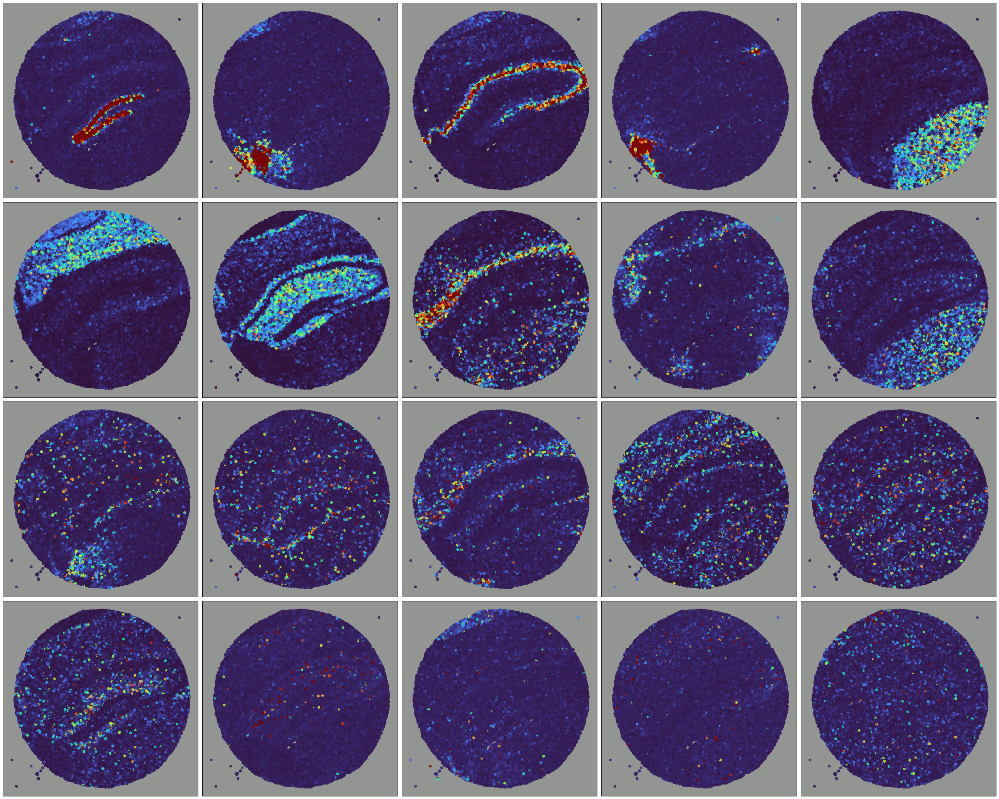

In [47]:
plot(factors, moran_idx)

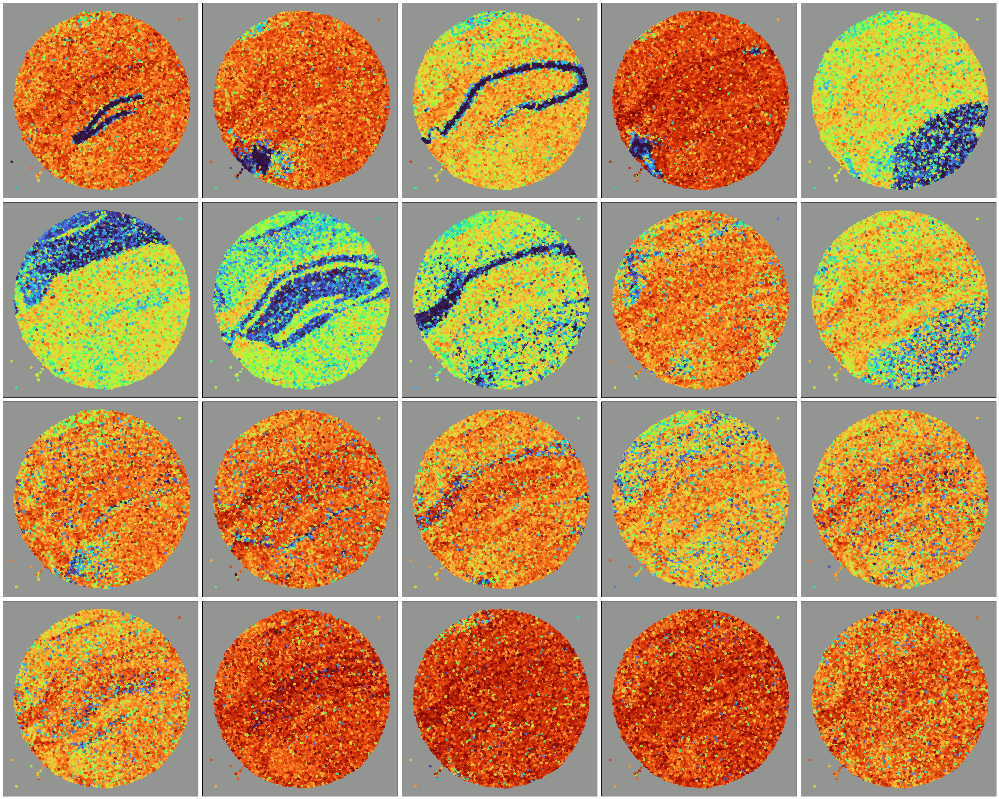

In [49]:
plot(factors_scales, moran_idx)

In [ ]:
size=7
fig, ax = plt.subplots(4, 5, figsize=(size*5, size*4), tight_layout=True)


def update(iteration):
    plot(np.exp(means[iteration]), moran_idx, ax=ax, size=size)
    fig.suptitle(f"Iteration: {iteration}, Loss: {losses[iteration*10]:0.2f}")
    fig.tight_layout()


anim = FuncAnimation(fig, update, frames=np.arange(0, 500, 30), interval=10)
plt.close()
anim.save("pnmf.mp4", fps=50)